In [1]:
import scanpy as sc
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

import sys
# spaxcr tools
sys.path.append('/storage/liuyi/11.spaxcr//code')
import spaxcr

/home/liuyi/miniconda3/envs/spatial/lib/python3.9/site-packages/Bio/Application/__init__.py:39: BiopythonDeprecationWarning: The Bio.Application modules and modules relying on it have been deprecated.

Due to the on going maintenance burden of keeping command line application
wrappers up to date, we have decided to deprecate and eventually remove these
modules.

We instead now recommend building your command line and invoking it directly
with the subprocess module.
  warnings.warn(
Matplotlib is building the font cache; this may take a moment.


In [2]:
cellbin = sc.read_h5ad('/storage/liuyi/09.ma_tcr/bulid_meta/mc38_umi/mc38.cellbin.h5ad')
rna = sc.read_h5ad('/data_hub1/fengyu/07.NBT/ST/12.MC38.B02804B5/bin_50_old/MC38_bin50.h5ad')

In [3]:
tra_cells = cellbin.uns['XCR']['i2c']['TRA'].keys()
trb_cells = cellbin.uns['XCR']['i2c']['TRB'].keys()
tcr_cells = list(tra_cells) + list(trb_cells)
tcr_cells = list(set(tcr_cells))

In [4]:
rna = rna[rna.obs['annotation_level1']!='low_quality_region']
rna.obsm['spatial'] = rna.obs[['x','y']].values

/tmp/ipykernel_780477/4292839595.py:2: ImplicitModificationWarning: Setting element `.obsm['spatial']` of view, initializing view as actual.
  rna.obsm['spatial'] = rna.obs[['x','y']].values


In [5]:
tcellbin = sc.read_h5ad("/storage/zangyupeng/00.Data/07.NBT/ST/12.MC38.B02804B5/T.rna.annotated.h5ad")
tcellbin = tcellbin[tcr_cells].copy()

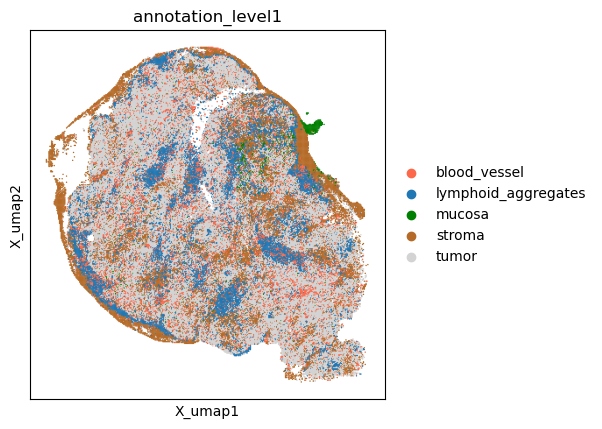

In [6]:
sc.pl.spatial(rna,color = 'annotation_level1',spot_size  =80,basis = 'X_umap')

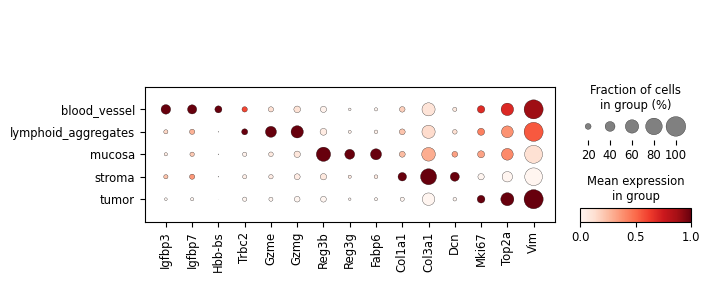

In [7]:
sc.pl.dotplot(rna[rna.obs.annotation_level1!='low_quality_region'],['Igfbp3','Igfbp7','Hbb-bs','Trbc2','Gzme','Gzmg','Reg3b','Reg3g','Fabp6','Col1a1','Col3a1','Dcn','Mki67','Top2a','Vim'],groupby='annotation_level1',standard_scale='var')

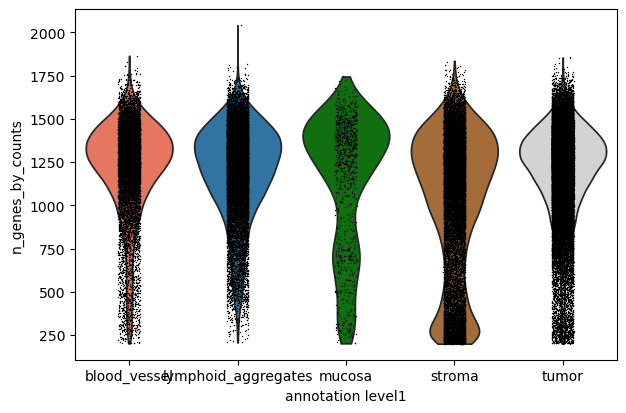

In [8]:
sc.pl.violin(rna,['n_genes_by_counts'],groupby='annotation_level1',rasterized=True)

/tmp/ipykernel_780477/3009668049.py:10: FutureWarning: The behavior of Series.replace (and DataFrame.replace) with CategoricalDtype is deprecated. In a future version, replace will only be used for cases that preserve the categories. To change the categories, use ser.cat.rename_categories instead.
  tcellbin.obs['annotation2'] = tcellbin.obs['annotation'].replace({'T_ifng':'T_ccr7'})


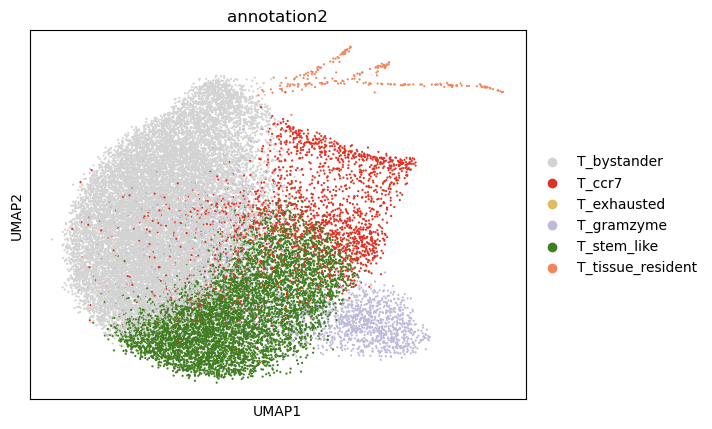

In [9]:
color_dict = {
    'T_bystander':'#D3D3D3',
    'T_ccr7':'#E03122',
    'T_exhausted':"#E0BC62",
    'T_gramzyme':'#bebada',
    'T_stem_like':'#417E22',
    'T_tissue_resident':"#EF865C",
}

tcellbin.obs['annotation2'] = tcellbin.obs['annotation'].replace({'T_ifng':'T_ccr7'})
tcellbin.uns['annotation2_colors'] = [ color_dict[i] for i in tcellbin.obs['annotation2'].cat.categories]
sc.pl.umap(tcellbin,color = 'annotation2',s = 10)

In [10]:
cellidslist = []
colors = []
for cell_anno,color in color_dict.items():
    cells = tcellbin[tcellbin.obs['annotation2'] == cell_anno].obs_names.tolist()
    cellidslist.append(cells)
    colors.append(color)
cellbin.uns['hull'] = cellbin.uns['hull'].astype(int)
rna.obsm['spatial'] = rna.obs[['x','y']].values
rna.obsm['spatial'] = rna.obsm['spatial'].astype(int)
background = pd.DataFrame(rna.obsm['spatial'],columns = ['x','y'])
background['anno'] = rna.obs['annotation_level1'].to_list()
rna_anno_dict = dict(zip(rna.obs['annotation_level1'].cat.categories,rna.uns['annotation_level1_colors']))

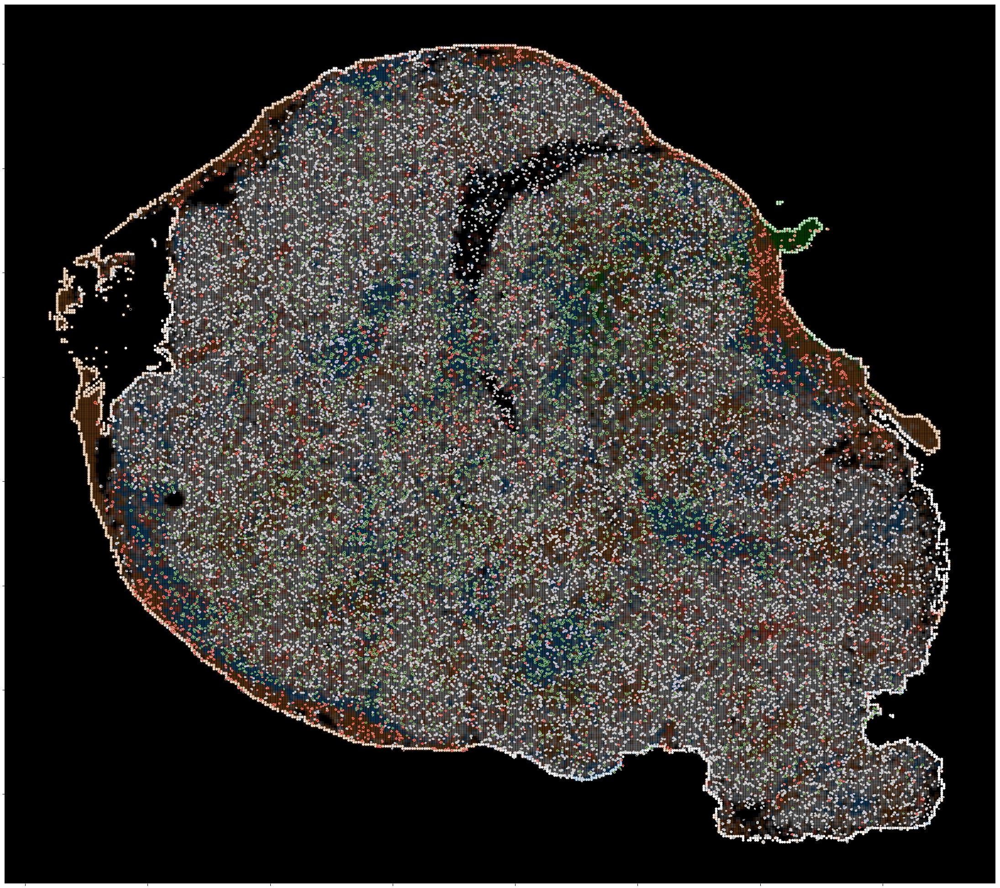

In [11]:
hull = cellbin.uns['hull']

fig,ax = plt.subplots(figsize = (28,25))
ax.set_facecolor('black')
ax.scatter(hull[:,0],hull[:,1],edgecolors = None, color = 'white', s = 10,rasterized =True)

for anno,tmp in background.groupby('anno'):
    ax.scatter(tmp['x'],tmp['y'],marker='s' ,edgecolors=None,rasterized =True,alpha = 0.1,color = rna_anno_dict[anno])

total_cell = list(set([ cell for i in cellidslist for cell in i]))
subcellpose = cellbin.uns['cellpose'][cellbin.uns['cellpose']['cellID'].isin(total_cell)]
suboutline = cellbin.uns['outline'][cellbin.uns['outline']['cellID'].isin(total_cell)]

for cellids,color in zip(cellidslist,colors):
    plotspot = subcellpose[subcellpose['cellID'].isin(cellids)]
    outlinespot = suboutline[suboutline['cellID'].isin(cellids)]
    ax.scatter(plotspot['x'],plotspot['y'],s = 0.01 ,color = color,edgecolors=None,rasterized =True,alpha = 0.2)
    sns.scatterplot(x = outlinespot['x'],y = outlinespot['y'],color = 'white',s = 0.05,edgecolors=None,rasterized =True,ax = ax)


ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.set_xlabel('')
ax.set_ylabel('')
ax.set_xticklabels([])
ax.set_yticklabels([])
ax.invert_yaxis()
ax.grid(False)
fig.show()

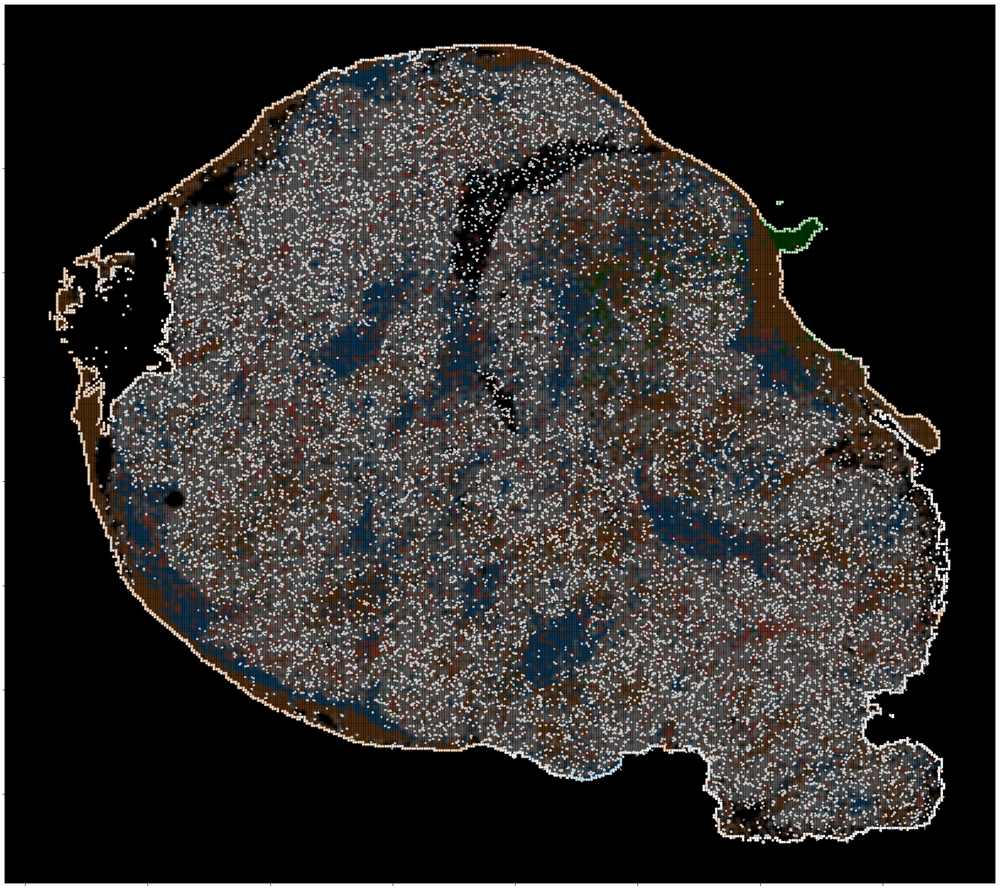

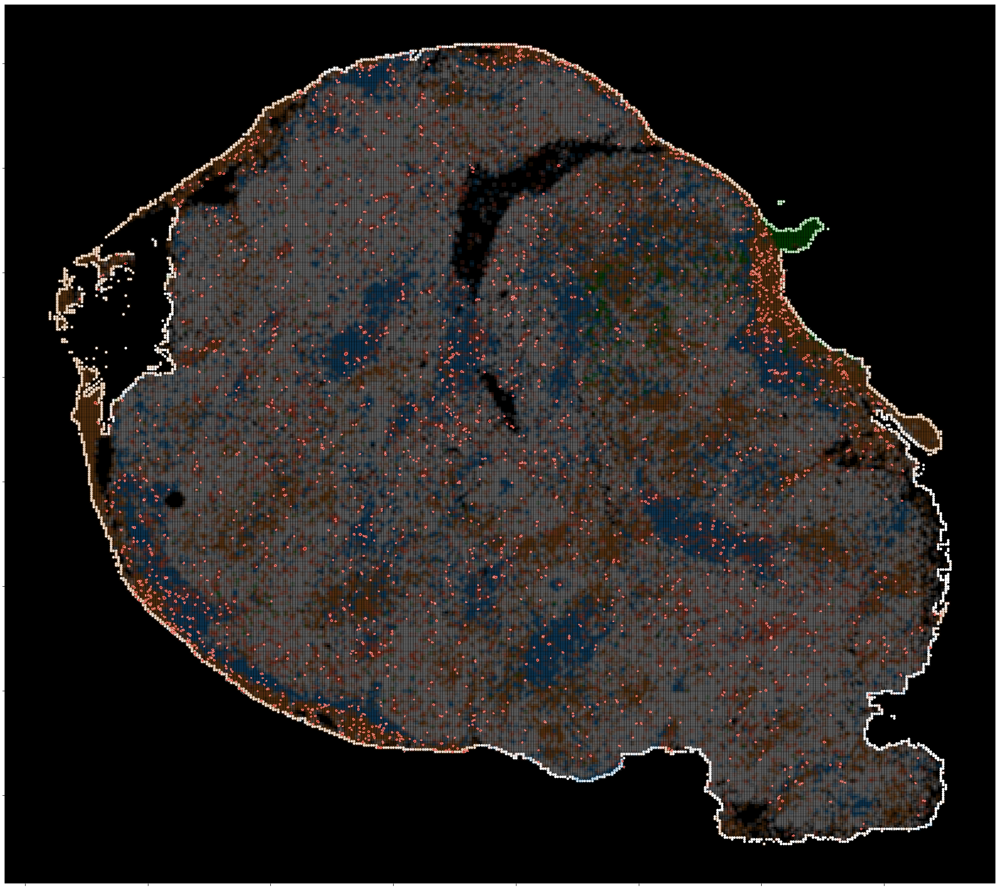

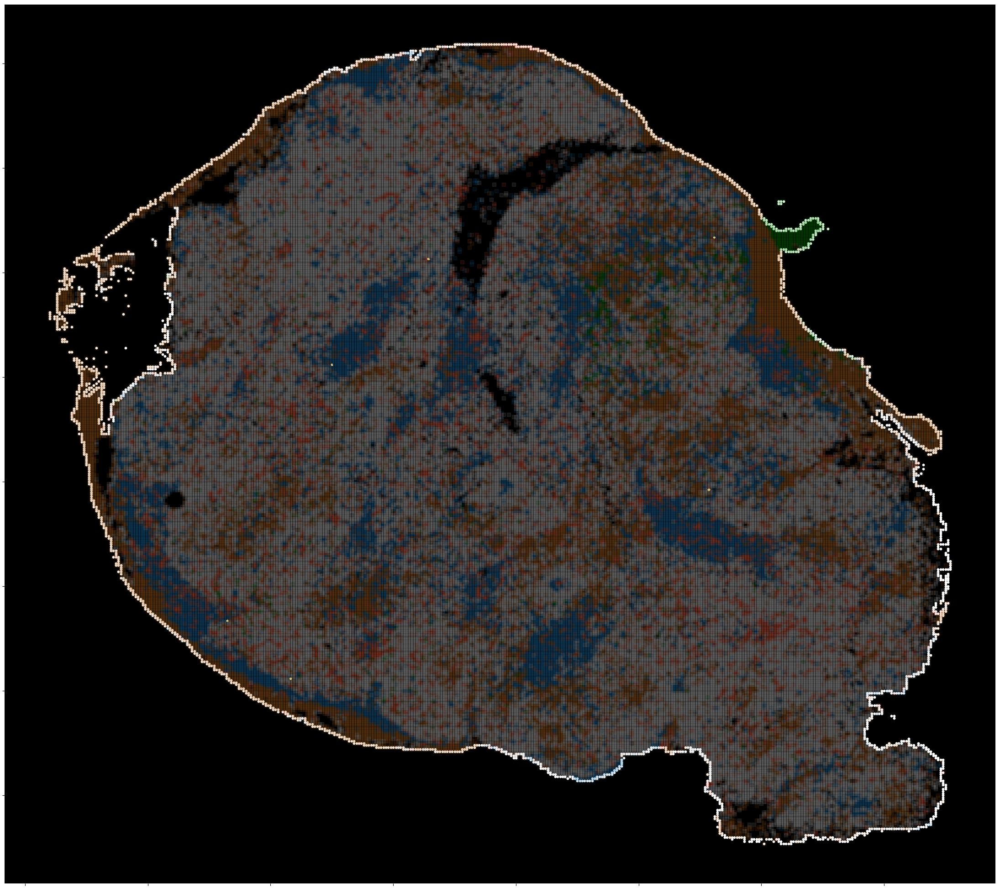

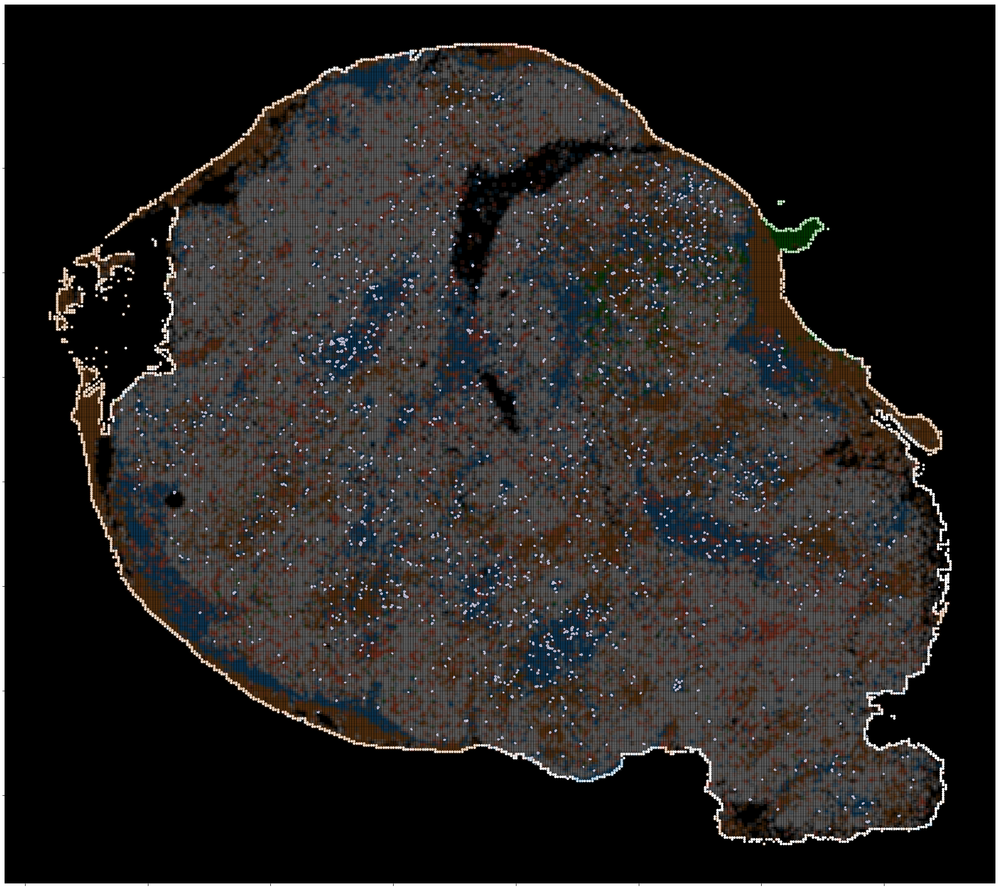

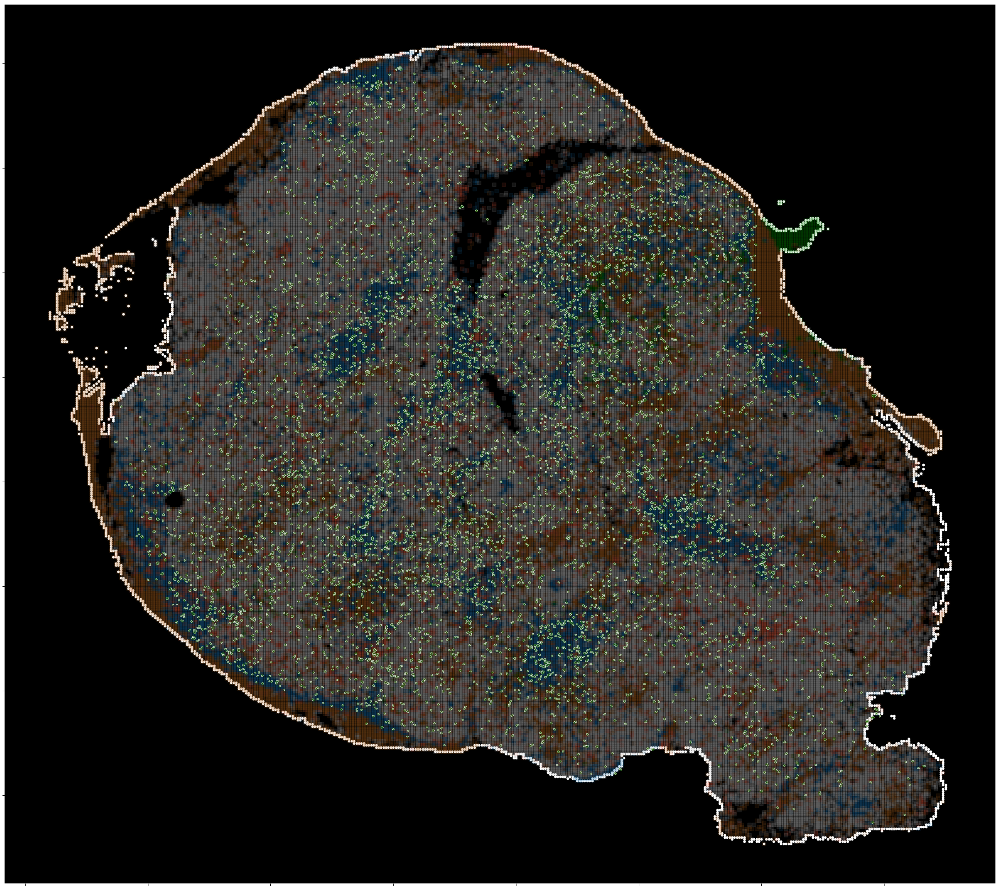

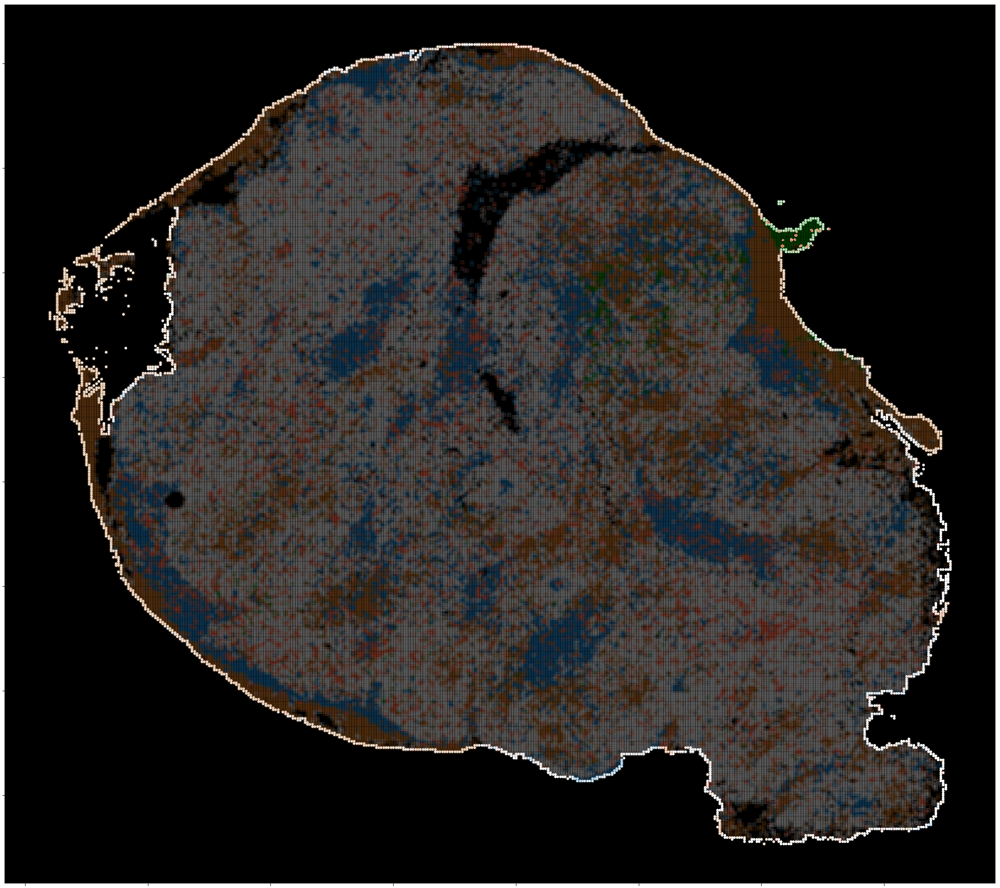

In [12]:
hull = cellbin.uns['hull']

total_cell = list(set([ cell for i in cellidslist for cell in i]))
subcellpose = cellbin.uns['cellpose'][cellbin.uns['cellpose']['cellID'].isin(total_cell)]
suboutline = cellbin.uns['outline'][cellbin.uns['outline']['cellID'].isin(total_cell)]

for cellids,color,celltype in zip(cellidslist,colors,color_dict.keys()):
    fig,ax = plt.subplots(figsize = (28,25))
    ax.set_facecolor('black')
    ax.scatter(hull[:,0],hull[:,1],edgecolors = None, color = 'white', s = 10,rasterized =True)

    for anno,tmp in background.groupby('anno'):
        ax.scatter(tmp['x'],tmp['y'],marker='s' ,edgecolors=None,rasterized =True,alpha = 0.1,color = rna_anno_dict[anno])
    plotspot = subcellpose[subcellpose['cellID'].isin(cellids)]
    outlinespot = suboutline[suboutline['cellID'].isin(cellids)]
    ax.scatter(plotspot['x'],plotspot['y'],s = 0.01 ,color = color,edgecolors=None,rasterized =True,alpha = 0.2)
    sns.scatterplot(x = outlinespot['x'],y = outlinespot['y'],color = 'white',s = 0.05,edgecolors=None,rasterized =True,ax = ax)
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['left'].set_visible(False)
    ax.spines['bottom'].set_visible(False)
    ax.set_xlabel('')
    ax.set_ylabel('')
    ax.set_xticklabels([])
    ax.set_yticklabels([])
    ax.invert_yaxis()
    ax.grid(False)
    fig.show()

# pair

In [13]:
tra_cells = cellbin.uns['XCR']['i2c']['TRA']
trb_cells = cellbin.uns['XCR']['i2c']['TRB']
pair_cells = list(set(tra_cells.keys()).intersection(set(trb_cells.keys())))

In [14]:
cellbin = spaxcr.pp.updatexcr(cellbin)

Chain
> Update TRA-CDR3: 188 → 186
> Update TRB-CDR3: 389 → 386


In [15]:
len(pair_cells)

993

In [16]:
pair_candidate_list = []
restcell = []
for cell in pair_cells:
    tra_chain = list(tra_cells.get(cell))
    trb_chain = list(trb_cells.get(cell))
    if len(tra_chain)==1 and len(trb_chain) == 1:
        for tra in tra_chain:
            for trb in trb_chain:
                pair_candidate = tra + '||' + trb
                pair_candidate_list.append([pair_candidate,cell])
    else:
        restcell.append(cell)
pair_cdr3 = pd.DataFrame(pair_candidate_list)
pair_cdr3_vc = pair_cdr3[0].value_counts().to_frame()
pair_cdr3_vc['rank'] = range(pair_cdr3_vc.shape[0])
vcdict = dict(zip(pair_cdr3_vc.index,pair_cdr3_vc['rank']))

In [17]:
new_candiadte = []
final_restcell = []
for idx,cell in enumerate(restcell):
    tra_chain = list(tra_cells.get(cell))
    trb_chain = list(trb_cells.get(cell))
    total_candidate = []
    for tra in tra_chain:
        for trb in trb_chain:
            pair_candidate = tra + '||' + trb
            total_candidate.append(pair_candidate)
    min_loc = np.argmin([ vcdict.get(i,10000) for i in total_candidate])
    min_rank_cdr3 = total_candidate[min_loc]
    cdr3_rank = vcdict.get(min_rank_cdr3,10000)
    if cdr3_rank != 10000:
        new_candiadte.append([min_rank_cdr3,cell])
    else:
        final_restcell.append(cell)
new_pair_cdr3 = pd.DataFrame(new_candiadte)
round1_pair_cdr3 = pd.concat([pair_cdr3,new_pair_cdr3])

In [18]:
new_candiadte = []
for idx,cell in enumerate(final_restcell):
    tra_chain = list(tra_cells.get(cell))
    trb_chain = list(trb_cells.get(cell))
    total_candidate = []
    for tra in tra_chain:
        for trb in trb_chain:
            pair_candidate = tra + '||' + trb
            total_candidate.append(pair_candidate)
    min_loc = np.argmin([ vcdict.get(i,10000) for i in total_candidate])
    min_rank_cdr3 = total_candidate[min_loc]
    cdr3_rank = vcdict.get(min_rank_cdr3,10000)
    if cdr3_rank != 10000:
        new_candiadte.append([min_rank_cdr3,cell])
    else:
        final_restcell.append(cell)
new_pair_cdr3 = pd.DataFrame(new_candiadte)
round2_pair_cdr3 = pd.concat([round1_pair_cdr3,new_pair_cdr3])

In [19]:
round2_pair_cdr3.shape[0]

993

In [20]:
pair_cdr3_vc = round2_pair_cdr3[0].value_counts().to_frame()
pair_cdr3_vc['rank'] = range(pair_cdr3_vc.shape[0])

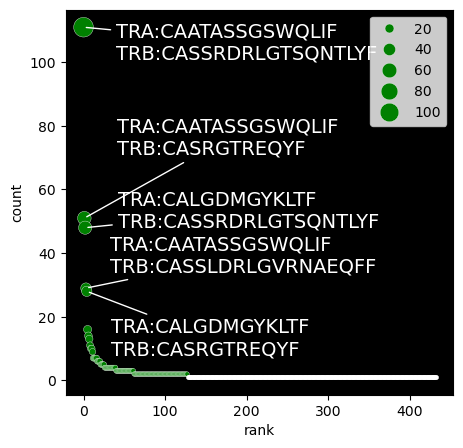

In [21]:
fig,ax = plt.subplots(figsize = (5,5))
sns.scatterplot(data = pair_cdr3_vc[pair_cdr3_vc['count']>=2], x = 'rank',y = 'count',edgecolor = 'white',color = 'green',sizes=(10,200),size = 'count',ax = ax)
sns.scatterplot(data = pair_cdr3_vc[pair_cdr3_vc['count']==1], x = 'rank',y = 'count',edgecolor = None,color = 'white',s = 10,ax = ax)
ax.set_facecolor('black')
top5 = pair_cdr3_vc.nlargest(5, 'count')

m = 0
for i in top5.index:
    m+=1
    pos_x = pair_cdr3_vc.loc[i, 'rank']
    pos_y = pair_cdr3_vc.loc[i, 'count']
    if m == 1:
        pos_x += 40
        pos_y -= 10
    if m == 2:
        pos_x += 40
        pos_y += 20
    if m == 3:
        pos_x += 40
        pos_y += 0
    if m == 4:
        pos_x += 30
        pos_y += 5
    if m == 5:
        pos_x += 30
        pos_y -= 20

    plt.annotate(
        'TRA:' + i.split('||')[0].split('@')[0] + '\nTRB:' + i.split('||')[1].split('@')[0],  # Label text
        xy=(pair_cdr3_vc.loc[i, 'rank'], pair_cdr3_vc.loc[i, 'count']),  # Point coordinates
        xytext=(pos_x, pos_y),  # Text coordinates
        fontsize=14, color='white',
        arrowprops=dict(arrowstyle='-', color='white')  # Draw a black line
    )

plt.grid(False)
plt.show()

In [22]:
top_cells = []
for cell in pair_cells:
    tra_chain = list(tra_cells.get(cell))
    trb_chain = list(trb_cells.get(cell))
    for tra in tra_chain:
        for trb in trb_chain:
            pair_candidate = tra + '||' + trb
            if pair_candidate == pair_cdr3_vc.index[0]:
                top_cells.append(cell)

In [23]:
def combine_cellbin_binadata(cellbin_adata,bin_adata,obs,binsize = 50,basis = 'spatial'):
    rnaobs = bin_adata.obs.copy()
    rnaobs['x'] = bin_adata.obsm[basis][:,0]
    rnaobs['y'] = bin_adata.obsm[basis][:,1]
    rnaobs['id'] = rnaobs['x'].map(str) + '_' + rnaobs['y'].map(str) 
    match_dict = dict(zip(rnaobs['id'],rnaobs[obs]))
    cellbin_adataobs = cellbin_adata.obs.copy()
    cellbin_adataobs['id'] = (cellbin_adataobs['x']//binsize*binsize).astype(int).astype(str) + '_'+(cellbin_adataobs['y']//binsize*binsize).astype(int).astype(str)
    cellbin_adataobs['add'] = cellbin_adataobs['id'].map(match_dict)
    cellbin_adata.obs[obs] = cellbin_adataobs['add']

In [24]:
combine_cellbin_binadata(cellbin,rna,"annotation_level1")

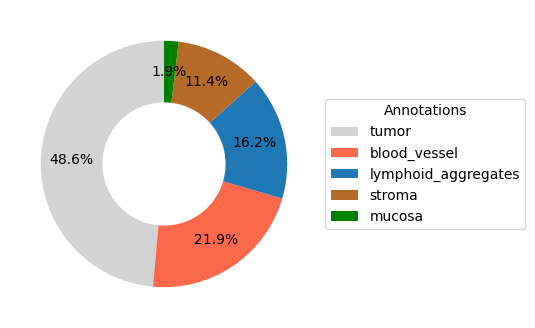

In [25]:
subcellbin = cellbin[cellbin.obs['annotation_level1']!='low_quality_region']
annotation_counts = subcellbin[subcellbin.obs_names.isin(top_cells)].obs['annotation_level1'].value_counts()
colors = dict(zip(rna.obs['annotation_level1'].cat.categories,rna.uns['annotation_level1_colors']))

plt.figure(figsize=(4, 4))
wedges, texts, autotexts = plt.pie(
    annotation_counts, 
    labels=None,
    autopct='%1.1f%%',
    pctdistance=0.75, 
    wedgeprops={'width': 0.5},
    startangle=90,colors = annotation_counts.index.map(colors).tolist()
)
plt.legend(wedges, annotation_counts.index, title="Annotations", loc="center left", bbox_to_anchor=(1, 0, 0.5, 1))
plt.show()

In [26]:
rna = rna[rna.obs['annotation_level1'] !='low_quality_region']
sc.tl.rank_genes_groups(rna, "annotation_level1", method="wilcoxon")

/home/liuyi/miniconda3/envs/spatial/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:645: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[key_added] = {}


In [27]:
df = pd.DataFrame(rna.uns["rank_genes_groups"]["names"]).head(5)

In [28]:
gene_list =[]
for idx,row in df.T.iterrows():
    gene_list.extend(row)

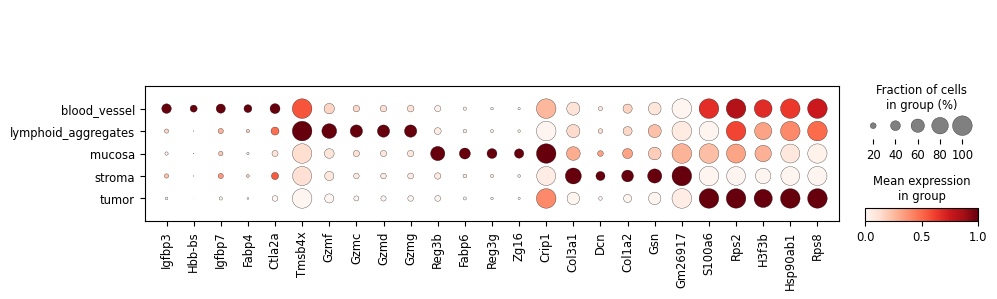

In [29]:
sc.pl.dotplot(rna,gene_list,groupby = 'annotation_level1',standard_scale='var')#save = 'sfig3b.rankgene.pdf')

In [30]:
totalcellbin = sc.read_h5ad('/storage/liuyi/09.ma_tcr/article/Fig2/mc38.cellbin.nf.h5ad')

In [31]:
sc.pp.normalize_total(totalcellbin, target_sum=1e4)
sc.pp.log1p(totalcellbin)

In [32]:
totalcellbin.obs['tcellornot'] = totalcellbin.obs_names.isin(tcellbin.obs_names)
totalcellbin.obs['tcellornot'] = totalcellbin.obs['tcellornot'].map({True:'Tcell',False:'other'})

In [33]:
tmpdf = totalcellbin[:,['Ptprc','Cd3e','Cd4','Cd8a','Trac','Trbc1','Trbc2']].to_df()

In [34]:
tmpdf['tcell'] = totalcellbin.obs['tcellornot']

In [35]:
tmpdf = tmpdf.melt(id_vars=['tcell'], value_vars=['Ptprc','Cd3e','Cd4','Cd8a','Trac','Trbc1','Trbc2'], var_name='measure', value_name='value')

In [36]:
tcellbin.obs['annotation2'] = tcellbin.obs['annotation'].replace({'T_ifng':'T_ccr7'})

/tmp/ipykernel_780477/1639699663.py:1: FutureWarning: The behavior of Series.replace (and DataFrame.replace) with CategoricalDtype is deprecated. In a future version, replace will only be used for cases that preserve the categories. To change the categories, use ser.cat.rename_categories instead.
  tcellbin.obs['annotation2'] = tcellbin.obs['annotation'].replace({'T_ifng':'T_ccr7'})


In [37]:
tcellbin.obs['annotation2'].value_counts()

annotation2
T_bystander          16972
T_stem_like           6750
T_ccr7                2299
T_gramzyme            1631
T_tissue_resident      206
T_exhausted              6
Name: count, dtype: int64

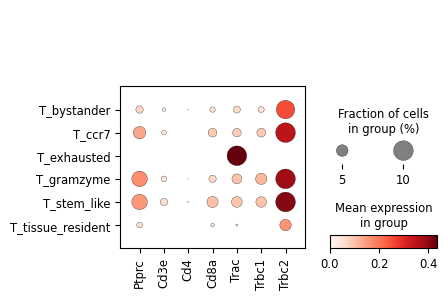

In [38]:
sc.pl.dotplot(tcellbin,['Ptprc','Cd3e','Cd4','Cd8a','Trac','Trbc1','Trbc2'],groupby = 'annotation2',dot_max = 0.1)

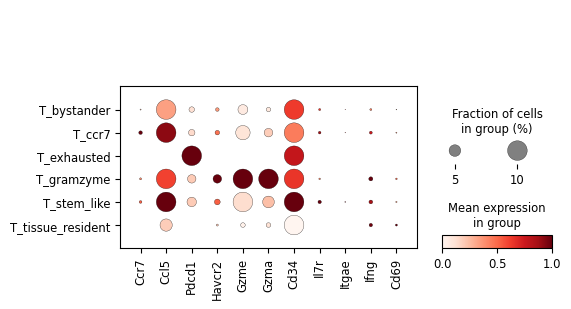

In [39]:
sc.pl.dotplot(tcellbin,['Ccr7','Ccl5','Pdcd1','Havcr2','Gzme','Gzma','Cd34','Il7r','Itgae','Ifng','Cd69'],groupby = 'annotation2',standard_scale='var',dot_max=0.1)

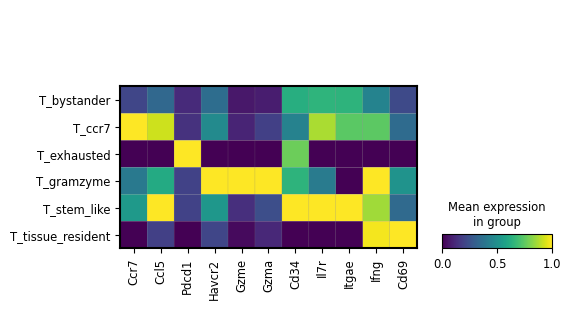

In [40]:
sc.pl.matrixplot(tcellbin,['Ccr7','Ccl5','Pdcd1','Havcr2','Gzme','Gzma','Cd34','Il7r','Itgae','Ifng','Cd69'],groupby = 'annotation2',standard_scale='var')

In [41]:
rna.obsm['spatial'] = rna.obs[['x','y']].values
rna.obsm['spatial'] = rna.obsm['spatial'].astype(int)

In [42]:
combine_cellbin_binadata(tcellbin,rna,obs='annotation_level1')

/tmp/ipykernel_780477/704573387.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  counts = df.groupby(['annotation2', 'annotation_level1']).size().unstack(fill_value=0)


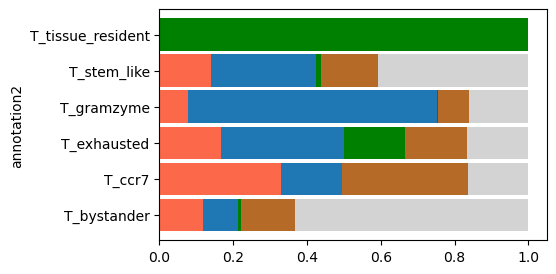

In [44]:
color_dict = dict(zip(rna.obs['annotation_level1'].cat.categories,rna.uns['annotation_level1_colors']))
df = tcellbin.obs[['annotation2','annotation_level1']]
counts = df.groupby(['annotation2', 'annotation_level1']).size().unstack(fill_value=0)
proportions = counts.div(counts.sum(axis=1), axis=0)
sorted_columns = proportions.columns[proportions.columns.isin(color_dict.keys())]
proportions = proportions[sorted_columns]
colors = [color_dict[key] for key in sorted_columns if key in color_dict]
fig,ax = plt.subplots(figsize= (5,3))
proportions.plot(kind='barh',color = colors, stacked=True,ax = ax,legend=False,width = 0.9)
ax.grid(False)
fig.show()

/storage/liuyi/11.spaxcr//code/spaxcr/plot/_expansion.py:74: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  fig.legend(bbox_to_anchor=(bbox_x, 0.5), loc="center left", borderaxespad=0)
/storage/liuyi/11.spaxcr//code/spaxcr/plot/_expansion.py:74: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  fig.legend(bbox_to_anchor=(bbox_x, 0.5), loc="center left", borderaxespad=0)


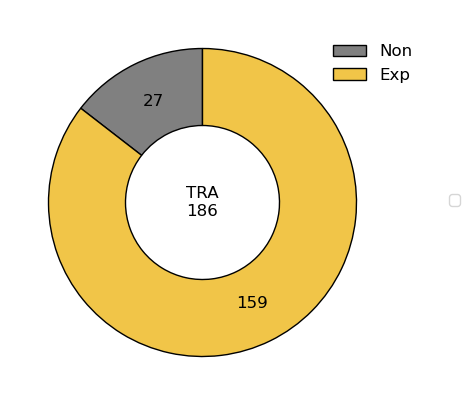

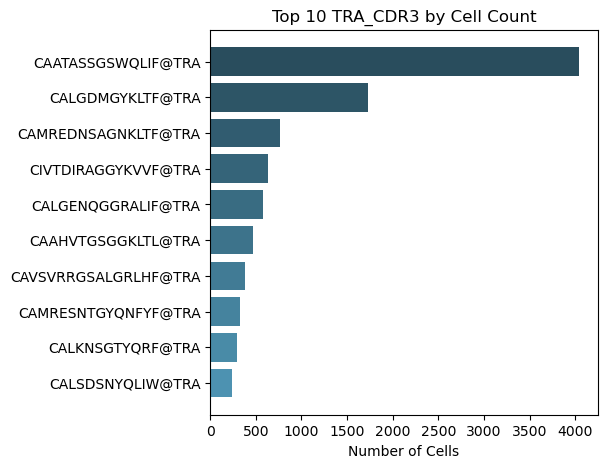

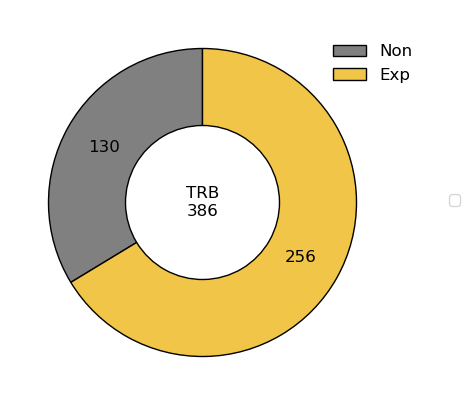

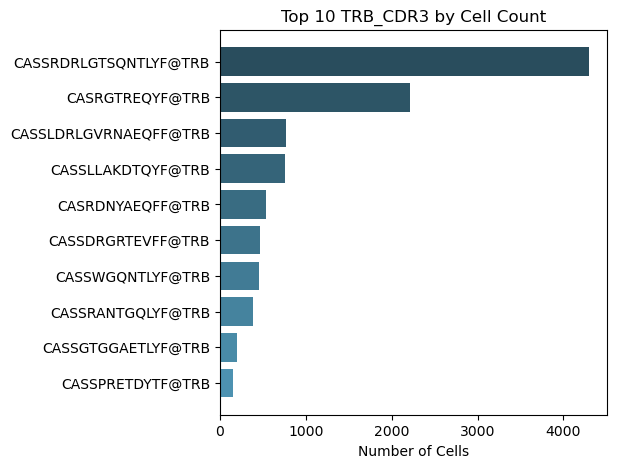

In [45]:
for chain in ['TRA','TRB']:
    spaxcr.pl.expandclone(cellbin,chains = chain)
    spaxcr.pl.topclone(cellbin,chain = chain,ntop = 10)

In [46]:
subtcell = tcellbin[top_cells]

/home/liuyi/miniconda3/envs/spatial/lib/python3.9/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c


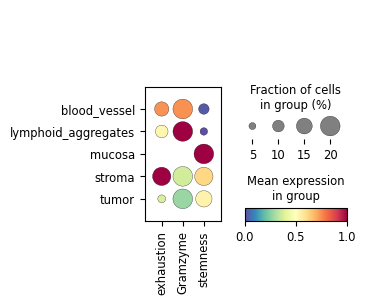

In [47]:
# top pair
sc.tl.score_genes(tcellbin,['Pdcd1','Ctla4','Tigit','Lag3','Havcr2'],score_name='exhaustion')
sc.tl.score_genes(tcellbin,['Gzma','Gzmd','Gzmf','Gzmg','Gzme','Gzmc','Gzmb'],score_name='Gramzyme')
sc.tl.score_genes(tcellbin,['Tcf7','Il7r','Sell','Ccr7','Mki67'],score_name='stemness')
sc.pl.dotplot(tcellbin[top_cells],['exhaustion','Gramzyme','stemness'],
              cmap='Spectral_r',groupby='annotation_level1',dot_max=0.2,standard_scale='var')

# meta

In [867]:
metadict = {
    'IBD':'/storage/fengyu/liuzhong/Cyclone/IBD1-B03501C4/metadata/IBD1-B03501C4.meta.gz',
    'mc38':'/storage/fengyu/liuzhong/Cyclone/12-MC38-OVA-M7-T/metadata/12-MC38-OVA-M7-T.meta.gz',
    'p15':'/storage/fengyu/liuzhong/Cyclone/15_ZLA_KC/metadata/15-ZLA_KC.meta.gz',
    'p7':'/storage/liuyi/09.ma_tcr/bulid_meta/7-ZXH_LC.meta.gz'
}
# meta_file = "/storage/fengyu/liuzhong/Cyclone/IBD1-B03501C4/metadata/IBD1-B03501C4.meta.gz"

/tmp/ipykernel_100335/2628766856.py:2: DtypeWarning: Columns (2,4,11,18) have mixed types. Specify dtype option on import or set low_memory=False.
  meta = pd.read_csv(metafile,compression = 'gzip')
/tmp/ipykernel_100335/2628766856.py:2: DtypeWarning: Columns (2,11,16) have mixed types. Specify dtype option on import or set low_memory=False.
  meta = pd.read_csv(metafile,compression = 'gzip')
/tmp/ipykernel_100335/2628766856.py:2: DtypeWarning: Columns (4,11,18) have mixed types. Specify dtype option on import or set low_memory=False.
  meta = pd.read_csv(metafile,compression = 'gzip')
/tmp/ipykernel_100335/2628766856.py:2: DtypeWarning: Columns (11,18) have mixed types. Specify dtype option on import or set low_memory=False.
  meta = pd.read_csv(metafile,compression = 'gzip')


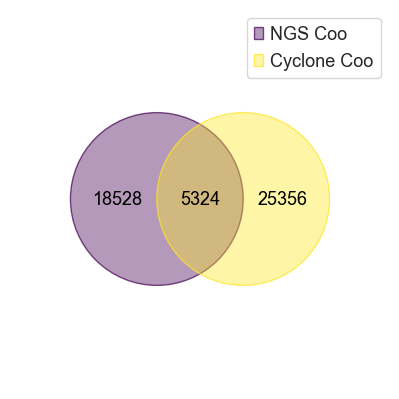

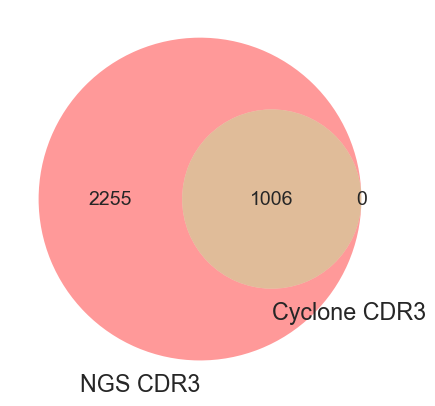

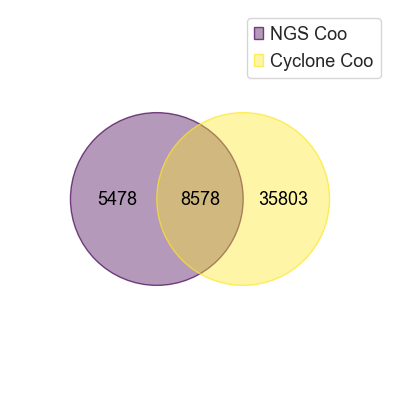

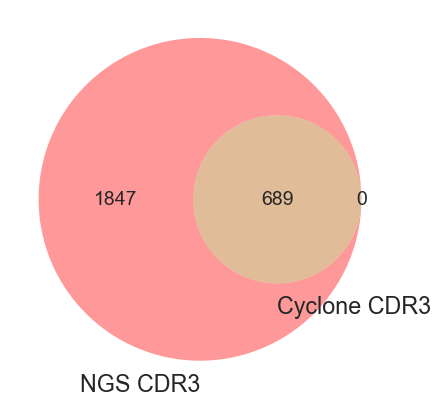

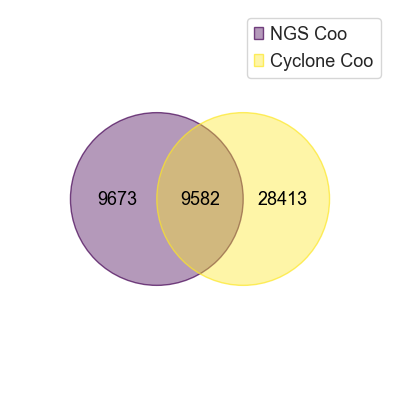

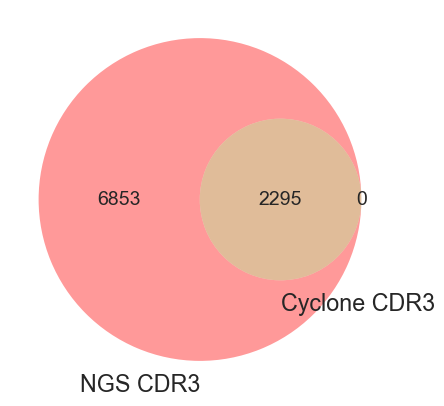

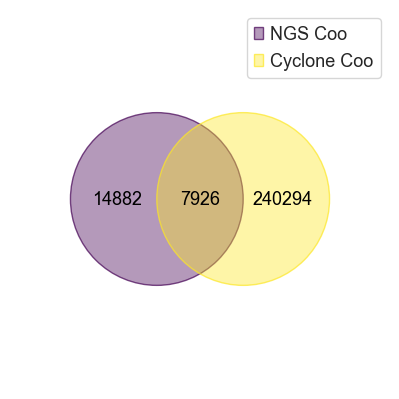

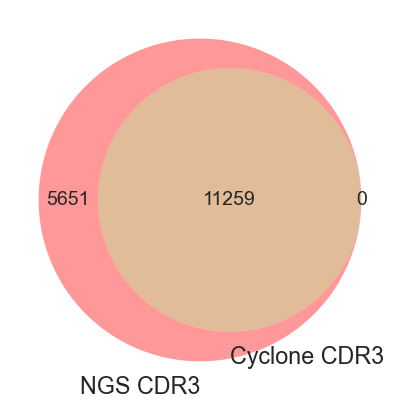

In [930]:
for sample,metafile in metadict.items():
    meta = pd.read_csv(metafile,compression = 'gzip')
    meta['tmp'] = meta['cdr3aa'] + '@' +meta['isotype']
    meta = meta[meta['func'] == 'Func'].copy()
    srmeta = meta[meta['readtype'] == 'SR'].copy()
    lrmeta = meta[meta['readtype'] == 'LR'].copy()

    from venn import venn
    fig,ax = plt.subplots(figsize = (5,5))
    venn({'NGS Coo':set(srmeta['loc']),'Cyclone Coo':set(lrmeta['loc'])},ax =ax)
    fig.savefig(f'./pair_venn/addFig3.{sample}.loc_veen.pdf',bbox_inches = 'tight')
    fig.show()

    ngs = set(list(srmeta['tmp'].tolist()) + list(lrmeta['tmp'].tolist()))
    cyclone = set(lrmeta['tmp'].tolist())

    from matplotlib_venn import venn2
    import matplotlib.pyplot as plt
    fig, ax = plt.subplots(figsize=(5, 5))

    venn2(subsets={'10': len(ngs - cyclone),   # NGS CDR3独有
                   '01': len(cyclone - ngs),   # Cyclone CDR3独有
                   '11': len(ngs & cyclone)},  # 两者共有
          set_labels=('NGS CDR3', 'Cyclone CDR3'), ax=ax)
    fig.savefig(f'./pair_venn/addFig3.{sample}.cdr3_venn.pdf',bbox_inches = 'tight')

# detect gene

In [82]:
import re
def get_Hits(x):
    if isinstance(x,float):
        return 'NA'
    return re.sub(r'\(.*?\)', '', x)


meta_dict = {
    'p7':'/storage/liuyi/09.ma_tcr/bulid_meta/7-ZXH_LC.meta.gz',
    'p15':'/storage/fengyu/liuzhong/Cyclone/15_ZLA_KC/metadata/15-ZLA_KC.meta.gz',
    'mc38':'/storage/fengyu/liuzhong/Cyclone/12-MC38-OVA-M7-T/metadata/12-MC38-OVA-M7-T.meta.gz',
    'ibd':'/storage/fengyu/liuzhong/Cyclone/IBD1-B03501C4/metadata/IBD1-B03501C4.meta.gz'
}
result_list = []
for sample,metefile in meta_dict.items():
    meta = pd.read_csv(metefile,compression  = 'gzip')
    for region in ['V','D','J','C']:
        meta[f'{region}Hits'] = meta[f'Align{region}Hits'].apply(lambda x: get_Hits(x).split('*')[0])
    bcr_meta = meta[meta['CombineIsotype'].isin(['IGHA','IGH','IGHM','IGHG','IGL','IGK','IGHA','IGHE'])]
    tcr_meta = meta[meta['CombineIsotype'].isin(['TRA','TRB'])]
    bcr_vgene = bcr_meta['VHits'].value_counts().shape[0]
    bcr_jgene = bcr_meta['JHits'].value_counts().shape[0]
    bcr_dgene = bcr_meta['DHits'].value_counts().shape[0]

    tcr_vgene = tcr_meta['VHits'].value_counts().shape[0]
    tcr_jgene = tcr_meta['JHits'].value_counts().shape[0]
    tcr_dgene = tcr_meta['DHits'].value_counts().shape[0]
    
    result_list.append([sample,bcr_vgene,bcr_jgene,bcr_dgene,tcr_vgene,tcr_jgene,tcr_dgene])

/tmp/ipykernel_1953132/1070403472.py:16: DtypeWarning: Columns (11,18) have mixed types. Specify dtype option on import or set low_memory=False.
  meta = pd.read_csv(metefile,compression  = 'gzip')
/tmp/ipykernel_1953132/1070403472.py:16: DtypeWarning: Columns (4,11,18) have mixed types. Specify dtype option on import or set low_memory=False.
  meta = pd.read_csv(metefile,compression  = 'gzip')
/tmp/ipykernel_1953132/1070403472.py:16: DtypeWarning: Columns (2,11,16) have mixed types. Specify dtype option on import or set low_memory=False.
  meta = pd.read_csv(metefile,compression  = 'gzip')
/tmp/ipykernel_1953132/1070403472.py:16: DtypeWarning: Columns (2,4,11,18) have mixed types. Specify dtype option on import or set low_memory=False.
  meta = pd.read_csv(metefile,compression  = 'gzip')


In [86]:
xcr_gene = pd.DataFrame(result_list,columns = ['sample','BCRV','BCRJ','BCRD','TCRV','TCRJ','TCRD'])

In [124]:
xcr_gene.to_csv('xcr.gene.csv')

In [133]:
def p_t(x):
    # if x.startswith('TRAC') or x.startswith('Trac'):
    #     return "TRA-C"
    # elif x.startswith('TRBC') or x.startswith('Trbc'):
    #     return "TRB-C"
    if x.startswith("TRAV") or x.startswith('Trav'):
        return "TCRV"
    elif x.startswith("TRBV") or x.startswith('Trbv'):
        return "TCRV"
    elif x.startswith("TRAJ") or x.startswith('Traj'):
        return "TCRJ"
    elif x.startswith("TRBJ") or x.startswith('Trbj'):
        return "TCRJ"
    elif x.startswith("TRAD") or x.startswith('Trad'):
        return "TCRD"
    elif x.startswith("TRBD") or x.startswith('Trbd'):
        return "TCRD"
    elif x.startswith("IGKV") or x.startswith("IGHV") or x.startswith("IGLV") or x.startswith("Igkv") or x.startswith("Ighv") or x.startswith("Iglv"): 
        return "BCRV"
    elif x.startswith("IGKJ") or x.startswith("IGHJ") or x.startswith("IGLJ") or x.startswith("Igkj") or x.startswith("Ighj") or x.startswith("Iglj"): 
        return "BCRJ"
    elif x.startswith("IGKD") or x.startswith("IGHD") or x.startswith("IGLD") or x.startswith("Igkd") or x.startswith("Ighd") or x.startswith("Igld"): 
        return "BCRD"
    return "other"

In [138]:
gem_dict = {
    'p7':'/storage/liuyi/09.ma_tcr/data_precoess/p7/m15_A0.clone.h5ad',
    'p15':'/data_hub1/fengyu/07.NBT/ST/15.KC.C03628C1/bin_50/annotated.h5ad',
    'mc38':'/data_hub1/fengyu/07.NBT/ST/12.MC38.B02804B5/bin_50_old/MC38_bin50.h5ad',
    'ibd':'/home/zangyupeng/05.ExtendDisk/00.Data/07.NBT/ST/IBD/B03501C4_norm.h5ad'
}

In [139]:
gem_result_list = []
for sample,rnafile in gem_dict.items():
    rnaadata = sc.read_h5ad(rnafile)
    if rnaadata.raw !=None:
        rnaadata = rnaadata.raw.to_adata()
    rnaadata.var['xcrgene'] = rnaadata.var_names.map(p_t)
    xcrgene = rnaadata[:,rnaadata.var['xcrgene']!='other'].var['xcrgene']
    xcrgenevc = xcrgene.value_counts()
    categories = ['BCRV', 'BCRJ', 'BCRD', 'TCRV', 'TCRJ', 'TCRD']
    xcrgenevc_reindexed = xcrgenevc.reindex(categories, fill_value=0)
    result = [sample] + xcrgenevc_reindexed.tolist()
    gem_result_list.append(result)

In [140]:
gem_gene = pd.DataFrame(gem_result_list,columns = ['sample','BCRV','BCRJ','BCRD','TCRV','TCRJ','TCRD'])

In [142]:
gem_gene.to_csv('gem.gene.csv')

In [195]:
xcr_melted = xcr_gene.melt(id_vars=['sample'], var_name='VJD_class', value_name='count')
xcr_melted['source'] = 'xcr'
gem_melted = gem_gene.melt(id_vars=['sample'], var_name='VJD_class', value_name='count')
gem_melted['source'] = 'gem'
combined_df = pd.concat([xcr_melted, gem_melted], ignore_index=True)
combined_df['class_type'] = combined_df['VJD_class'].str[-1]
combined_df['gene_type'] = combined_df['VJD_class'].str[:-1]
combined_df = combined_df[['sample', 'source', 'count', 'gene_type', 'class_type']]

In [236]:
bcrdf = combined_df[combined_df['gene_type'] == 'BCR']
tcrdf = combined_df[combined_df['gene_type'] == 'TCR']

In [237]:
bcrdf = bcrdf[bcrdf['sample'] != 'mc38']

In [238]:
bcrdf = bcrdf[bcrdf['source'] == 'xcr'].copy()
tcrdf = tcrdf[tcrdf['source'] == 'xcr'].copy()

In [239]:
# bcrdf['class_type'] = pd.Categorical(bcrdf['class_type'], categories=['V', 'D', 'J'], ordered=True)
# tcrdf['class_type'] = pd.Categorical(tcrdf['class_type'], categories=['V', 'D', 'J'], ordered=True)

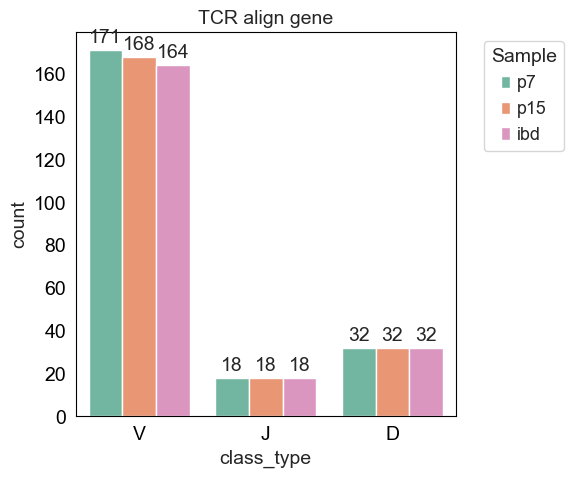

In [247]:
colordict = dict(zip(["p7",'p15','mc38','ibd'], ['#66c2a5','#fc8d62','#8da0cb','#e78ac3']))

plt.figure(figsize=(6, 5))
bar_plot = sns.barplot(data=bcrdf, x='class_type', y='count', hue='sample', palette=colordict)
for p in bar_plot.patches:
    if p.get_height() == 0:
        continue
    bar_plot.annotate( int(p.get_height()),  # 保留一位小数
                      (p.get_x() + p.get_width() / 2., p.get_height()),
                      ha='center', va='center', 
                      xytext=(0, 9), 
                      textcoords='offset points')
plt.title('TCR align gene')
plt.legend(title='Sample', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.grid(False)
plt.savefig('./sup2b.tcr.pdf')
plt.show()

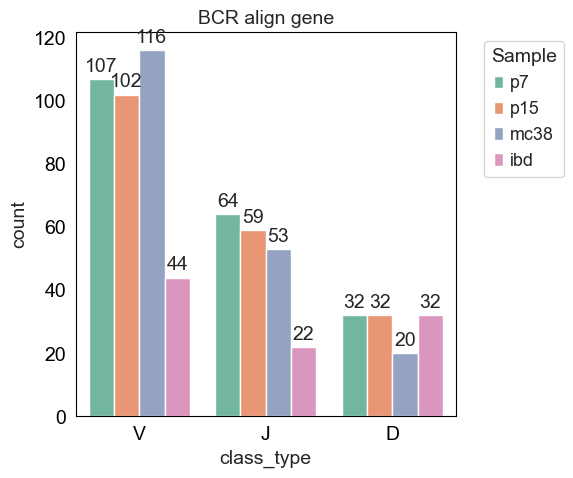

In [248]:
colordict = dict(zip(["p7",'p15','mc38','ibd'], ['#66c2a5','#fc8d62','#8da0cb','#e78ac3']))

plt.figure(figsize=(6, 5))
bar_plot = sns.barplot(data=tcrdf, x='class_type', y='count', hue='sample', palette=colordict)
for p in bar_plot.patches:
    if p.get_height() == 0:
        continue
    bar_plot.annotate( int(p.get_height()),  # 保留一位小数
                      (p.get_x() + p.get_width() / 2., p.get_height()),
                      ha='center', va='center', 
                      xytext=(0, 9), 
                      textcoords='offset points')
plt.title('BCR align gene')

plt.legend(title='Sample', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.grid(False)
plt.savefig('./sup2b.bcr.pdf')

plt.show()

In [269]:
meta_dict = {
    'p7':'/storage/liuyi/09.ma_tcr/bulid_meta/7-ZXH_LC.meta.gz',
    'p15':'/storage/fengyu/liuzhong/Cyclone/15_ZLA_KC/metadata/15-ZLA_KC.meta.gz',
    'mc38':'/storage/fengyu/liuzhong/Cyclone/12-MC38-OVA-M7-T/metadata/12-MC38-OVA-M7-T.meta.gz',
    'ibd':'/storage/fengyu/liuzhong/Cyclone/IBD1-B03501C4/metadata/IBD1-B03501C4.meta.gz'
}
result_list = []
for sample,metefile in meta_dict.items():
    meta = pd.read_csv(metefile,compression  = 'gzip')
    meta['tmp'] = meta['cdr3aa'] + '@' +meta['isotype']
    meta = meta[meta['func'] == 'Func'].copy()
    tcr_meta = meta[meta['isotype'].isin(['TRA','TRB'])].copy()
    bcr_meta = meta[meta['isotype'].isin(['IGL','IGK','IGH'])].copy()
    tcr_type = tcr_meta['cdr3aa'].value_counts().shape[0]
    bcr_type = bcr_meta['cdr3aa'].value_counts().shape[0]
    result_list.append([sample,tcr_type,bcr_type])

/tmp/ipykernel_1953132/449264129.py:9: DtypeWarning: Columns (11,18) have mixed types. Specify dtype option on import or set low_memory=False.
  meta = pd.read_csv(metefile,compression  = 'gzip')
/tmp/ipykernel_1953132/449264129.py:9: DtypeWarning: Columns (4,11,18) have mixed types. Specify dtype option on import or set low_memory=False.
  meta = pd.read_csv(metefile,compression  = 'gzip')
/tmp/ipykernel_1953132/449264129.py:9: DtypeWarning: Columns (2,11,16) have mixed types. Specify dtype option on import or set low_memory=False.
  meta = pd.read_csv(metefile,compression  = 'gzip')
/tmp/ipykernel_1953132/449264129.py:9: DtypeWarning: Columns (2,4,11,18) have mixed types. Specify dtype option on import or set low_memory=False.
  meta = pd.read_csv(metefile,compression  = 'gzip')


In [297]:
result = pd.DataFrame(result_list,columns = ['sample','TCR','BCR'])
result = result.melt(id_vars = 'sample')
result['sample'] = pd.Categorical(result['sample'], categories=['p7', 'p15', 'ibd','mc38'], ordered=True)

/tmp/ipykernel_1953132/4088047006.py:2: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  bar1 = sns.barplot(data = result[result['variable'] == 'TCR'],x = 'sample',y = 'value',ax = axs[0],edgecolor = 'black', palette=colordict)
/tmp/ipykernel_1953132/4088047006.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  bar2 = sns.barplot(data = result[result['variable'] == 'BCR'],x = 'sample',y = 'value',ax = axs[1],edgecolor = 'black', palette=colordict)


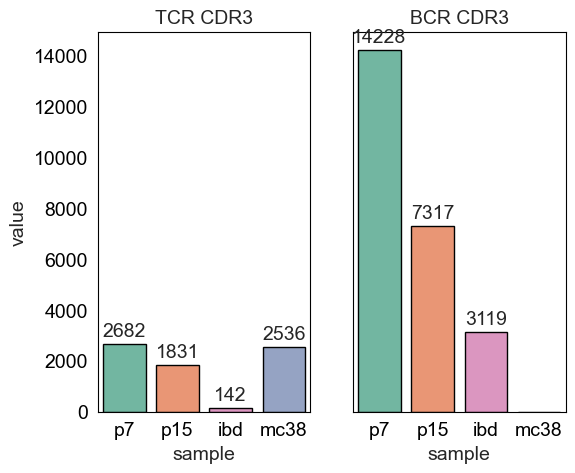

In [309]:
fig,axs =plt.subplots(1,2,figsize = (6,5),sharey=True)
bar1 = sns.barplot(data = result[result['variable'] == 'TCR'],x = 'sample',y = 'value',ax = axs[0],edgecolor = 'black', palette=colordict)
bar2 = sns.barplot(data = result[result['variable'] == 'BCR'],x = 'sample',y = 'value',ax = axs[1],edgecolor = 'black', palette=colordict)
axs[0].grid(False)
axs[1].grid(False)

for p in bar1.patches:
    if p.get_height() == 0:
        continue
    bar1.annotate( int(p.get_height()), 
                      (p.get_x() + p.get_width() / 2., p.get_height()),
                      ha='center', va='center', 
                      xytext=(0, 9), 
                      textcoords='offset points')
    
for p in bar2.patches:
    if p.get_height() == 0:
        continue
    bar2.annotate( int(p.get_height()), 
                      (p.get_x() + p.get_width() / 2., p.get_height()),
                      ha='center', va='center', 
                      xytext=(0, 9), 
                      textcoords='offset points')
axs[0].set_title('TCR CDR3')
axs[1].set_title('BCR CDR3')
fig.savefig('./fig1b.pdf')
fig.show()

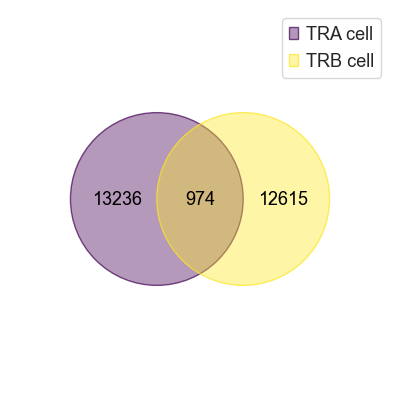

In [65]:
tracell = set(cellbin.uns['XCR']['i2c']['TRA'].keys())
trbcell = set(cellbin.uns['XCR']['i2c']['TRB'].keys())
from venn import venn

fig,ax = plt.subplots(figsize = (5,5))
venn({'TRA cell':tracell,'TRB cell':trbcell},ax = ax)
fig.savefig('./figures/sup2f.mc38.TCR.pair.pdf',bbox_inches = 'tight')